<a href="https://colab.research.google.com/github/evanxephon/faceswapinCycleGAN/blob/master/train_in_google_colab.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
!git clone https://github.com/evanxephon/faceswapinCycleGAN

Cloning into 'faceswapinCycleGAN'...
remote: Enumerating objects: 65, done.
remote: Counting objects: 100% (65/65), done.
remote: Compressing objects: 100% (61/61), done.
remote: Total 974 (delta 31), reused 0 (delta 0), pack-reused 909
Receiving objects: 100% (974/974), 10.61 MiB | 23.62 MiB/s, done.
Resolving deltas: 100% (605/605), done.


In [3]:
%cd 'faceswapinCycleGAN'

/content/faceswapinCycleGAN


In [0]:
!mkdir ./faceA
!mkdir ./faceA/rgb
!mkdir ./faceB
!mkdir ./faceB/rgb

In [0]:
!mkdir ./faceA/eyemask
!mkdir ./faceB/eyemask

In [6]:
!mv ../cage.zip ./faceA/rgb
%cd './faceA/rgb'
!unzip ./cage.zip
!rm ./cage.zip
%cd '../../'

!mv ../trump.zip ./faceB/rgb
%cd './faceB/rgb'
!unzip ./trump.zip
!rm ./trump.zip
%cd '../../'

/content/faceswapinCycleGAN/faceA/rgb
Archive:  ./cage.zip
  inflating: 102667226.jpg           
  inflating: 102668242.jpg           
  inflating: 102669741.jpg           
  inflating: 102670060.jpg           
  inflating: 102670068.jpg           
  inflating: 102670225.jpg           
  inflating: 102670483.jpg           
  inflating: 102671481.jpg           
  inflating: 102694815.jpg           
  inflating: 102695173.jpg           
  inflating: 102836618.jpg           
  inflating: 104614258.jpg           
  inflating: 104837047.jpg           
  inflating: 104844500.jpg           
  inflating: 104853338.jpg           
  inflating: 104853638.jpg           
  inflating: 104890518.jpg           
  inflating: 104890519.jpg           
  inflating: 104895441.jpg           
  inflating: 104920519.jpg           
  inflating: 104920521.jpg           
  inflating: 104924991.jpg           
  inflating: 104924993.jpg           
  inflating: 104955917.jpg           
  inflating: 104964186.jpg   

In [7]:
import imp
from utils import getrawface as gf
imp.reload(gf)

<module 'utils.getrawface' from '/content/faceswapinCycleGAN/utils/getrawface.py'>

In [0]:
from matplotlib import pyplot as plt
%matplotlib inline

In [0]:
import sys
sys.path.append('../src')
from src import detect_faces

In [10]:
import os 
import numpy as np
from IPython.display import display
from PIL import Image

def outputmask(imgpath, savepath):
    for img in os.listdir(imgpath):
        imgname = imgpath + img
        imgloaded = Image.open(imgname)
   
        boundingbox, landmarks = detect_faces(imgloaded)
        eyemask = np.zeros(imgloaded.size).astype('uint8')[:,:,None]
        try:
            print(landmarks.shape)
        except:
            pass
        if isinstance(landmarks, np.ndarray):
            if landmarks.shape[0] > 0:
                interval = int(landmarks.shape[1]/2)
                print(interval)
                eyeisat = [[int(landmarks.flatten()[i]), int(landmarks.flatten()[i+interval])] for i in range(2)]
        #print(eyeisat)
        eyemask = gf.getEyeMask(eyemask, eyeisat)
#         display(imgloaded)
#         display(Image.fromarray(eyemask))
        Image.fromarray(eyemask).save(savepath+img)
        
if __name__ == '__main__':
    dirAimg = './faceA/rgb/'
    dirBimg = './faceB/rgb/'
    dirAsavepath = './faceA/eyemask/'
    dirBsavepath = './faceB/eyemask/'
    outputmask(dirAimg, dirAsavepath)
    outputmask(dirBimg, dirBsavepath)

/content/faceswapinCycleGAN/src/first_stage.py:32: UserWarning: volatile was removed and now has no effect. Use `with torch.no_grad():` instead.
  img = Variable(torch.FloatTensor(_preprocess(img)), volatile=True)
/content/faceswapinCycleGAN/src/get_nets.py:70: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  a = F.softmax(a)
/content/faceswapinCycleGAN/src/detector.py:79: UserWarning: volatile was removed and now has no effect. Use `with torch.no_grad():` instead.
  img_boxes = Variable(torch.FloatTensor(img_boxes), volatile=True)
/content/faceswapinCycleGAN/src/get_nets.py:115: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  a = F.softmax(a)
/content/faceswapinCycleGAN/src/detector.py:100: UserWarning: volatile was removed and now has no effect. Use `with torch.no_grad():` instead.
  img_boxes = Variable(torch.FloatTensor(img_boxes), vol

(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(2, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5
(1, 10)
5


In [0]:
!mv ../resnet50_ft_weight.pkl ./

In [15]:
!git pull https://github.com/evanxephon/faceswapinCycleGAN

remote: Enumerating objects: 5, done.
remote: Counting objects: 100% (5/5), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 3 (delta 2), reused 0 (delta 0), pack-reused 0
Unpacking objects: 100% (3/3), done.
From https://github.com/evanxephon/faceswapinCycleGAN
 * branch            HEAD       -> FETCH_HEAD
Updating 4658ca4..b303411
Fast-forward
 network.py | 4 ++--
 1 file changed, 2 insertions(+), 2 deletions(-)


loss_D_A: 0.10606787353754044
loss_D_B: 0.10004442930221558
loss_G_A: 0.5353254675865173
loss_G_B: 0.6241084337234497
loss_G_adversarial_A: 0.10303409397602081
loss_G_reconstruction_A: 0.427136093378067
loss_G_mask_A: 0.005155278369784355
loss_G_adversarial_B: 0.10152826458215714
loss_G_reconstruction_B: 0.5173274874687195
loss_G_mask_B: 0.005252644885331392
epoch:0 reconstruction result


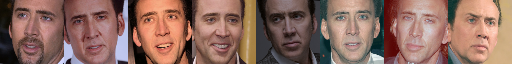

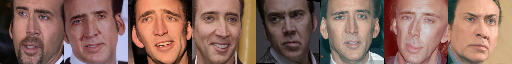

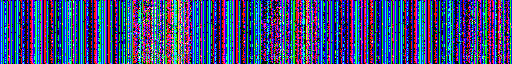

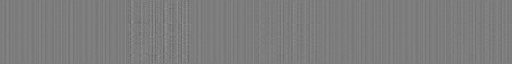

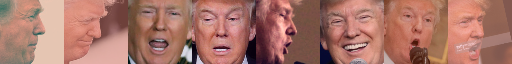

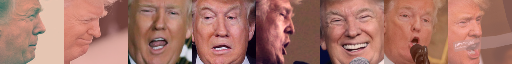

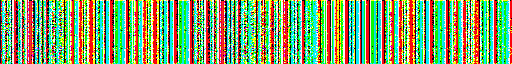

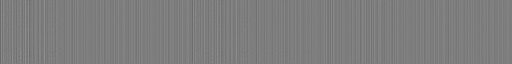

display result epoch: 0


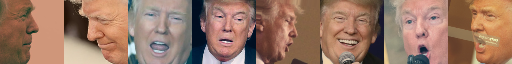

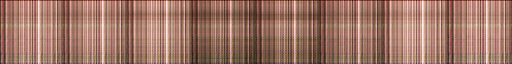

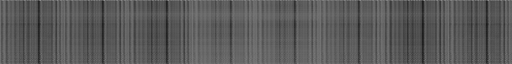

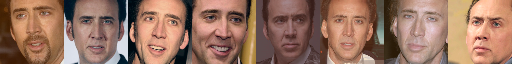

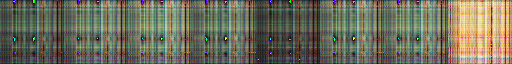

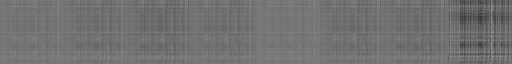

loss_D_A: 0.1035907045006752
loss_D_B: 0.09814994782209396
loss_G_A: 0.27289968729019165
loss_G_B: 0.2808828055858612
loss_G_adversarial_A: 0.10085739940404892
loss_G_reconstruction_A: 0.16805662214756012
loss_G_mask_A: 0.003985676448792219
loss_G_adversarial_B: 0.09949721395969391
loss_G_reconstruction_B: 0.17654384672641754
loss_G_mask_B: 0.004841744899749756
epoch:1 reconstruction result


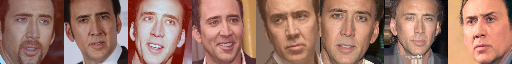

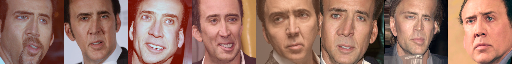

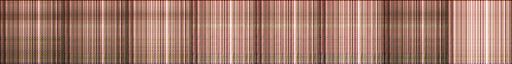

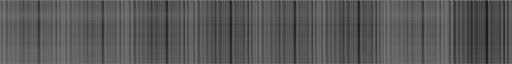

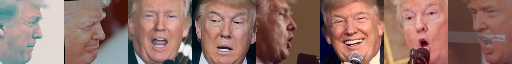

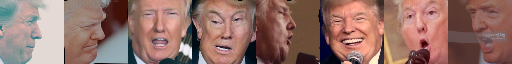

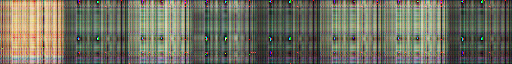

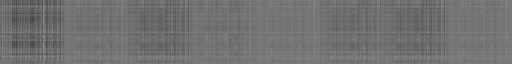

display result epoch: 1


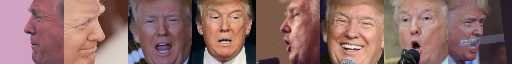

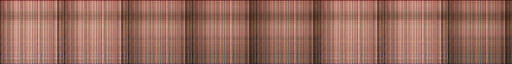

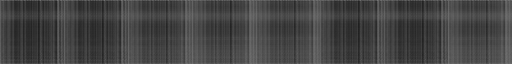

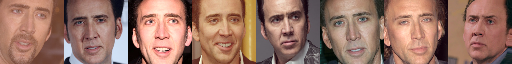

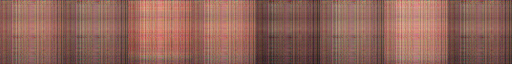

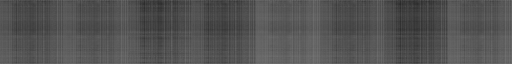

loss_D_A: 0.10119705647230148
loss_D_B: 0.09633397310972214
loss_G_A: 0.2522662878036499
loss_G_B: 0.256557434797287
loss_G_adversarial_A: 0.09873034805059433
loss_G_reconstruction_A: 0.15041561424732208
loss_G_mask_A: 0.0031203292310237885
loss_G_adversarial_B: 0.0975145697593689
loss_G_reconstruction_B: 0.155427023768425
loss_G_mask_B: 0.0036158328875899315
epoch:2 reconstruction result


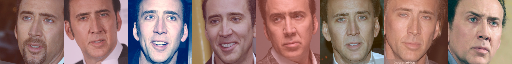

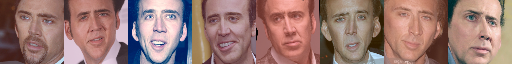

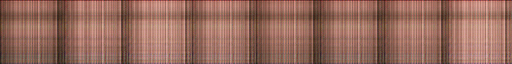

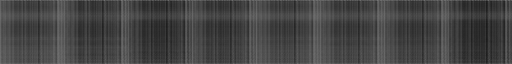

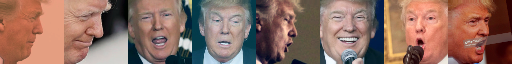

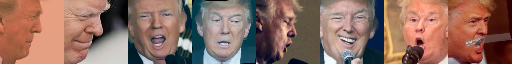

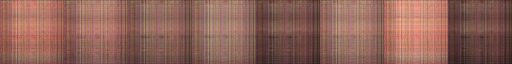

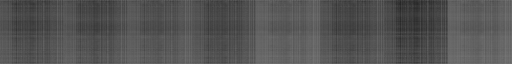

display result epoch: 2


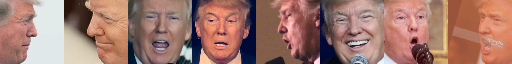

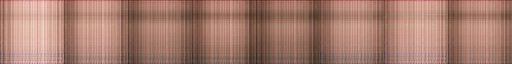

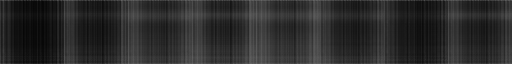

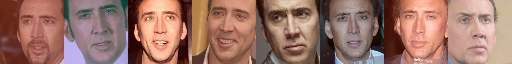

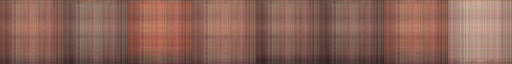

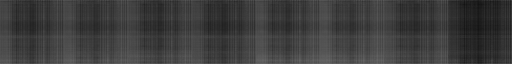

loss_D_A: 0.09890323877334595
loss_D_B: 0.09457629919052124
loss_G_A: 0.2495083063840866
loss_G_B: 0.25011011958122253
loss_G_adversarial_A: 0.09666194021701813
loss_G_reconstruction_A: 0.1508360356092453
loss_G_mask_A: 0.002010335912927985
loss_G_adversarial_B: 0.09558020532131195
loss_G_reconstruction_B: 0.15178796648979187
loss_G_mask_B: 0.002741948002949357
epoch:3 reconstruction result


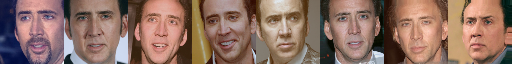

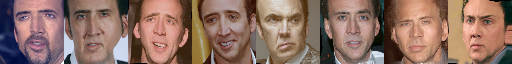

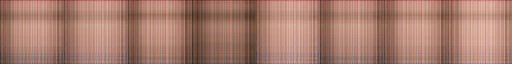

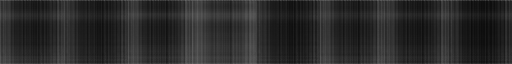

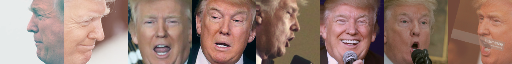

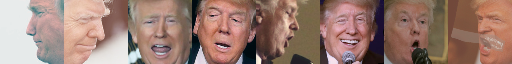

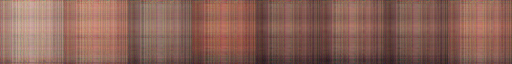

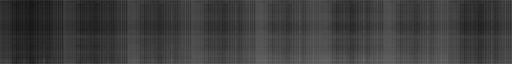

display result epoch: 3


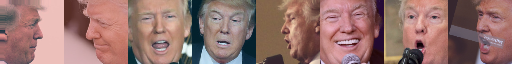

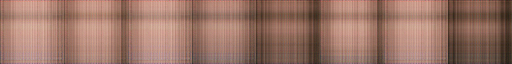

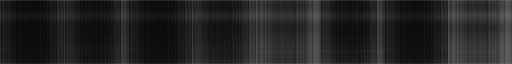

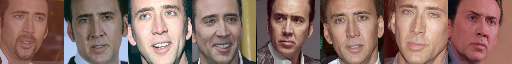

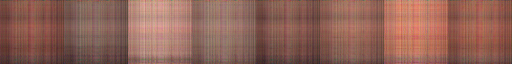

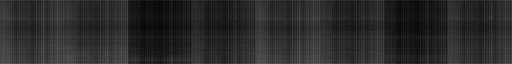

loss_D_A: 0.09670563042163849
loss_D_B: 0.09286923706531525
loss_G_A: 0.2372608780860901
loss_G_B: 0.22813615202903748
loss_G_adversarial_A: 0.09465035051107407
loss_G_reconstruction_A: 0.14096195995807648
loss_G_mask_A: 0.0016485758824273944
loss_G_adversarial_B: 0.09369125217199326
loss_G_reconstruction_B: 0.13245563209056854
loss_G_mask_B: 0.0019892766140401363
epoch:4 reconstruction result


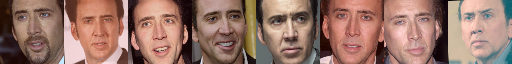

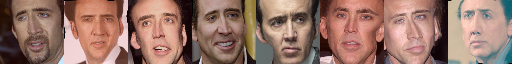

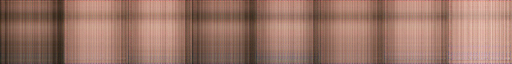

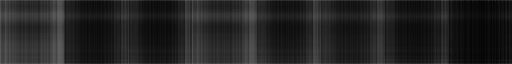

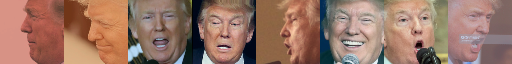

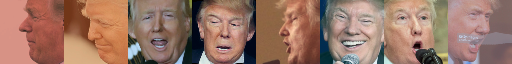

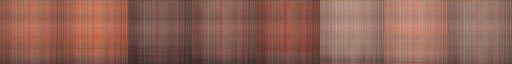

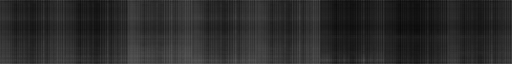

display result epoch: 4


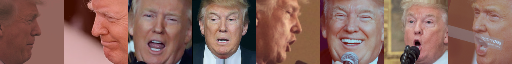

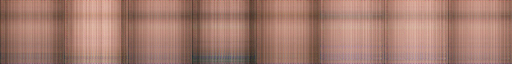

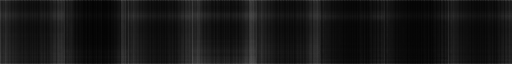

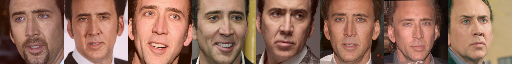

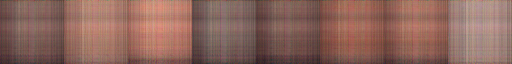

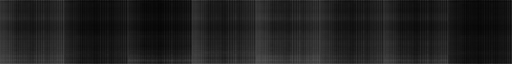

loss_D_A: 0.09460058063268661
loss_D_B: 0.09121125191450119
loss_G_A: 0.22489456832408905
loss_G_B: 0.21924202144145966
loss_G_adversarial_A: 0.09269370883703232
loss_G_reconstruction_A: 0.13112618029117584
loss_G_mask_A: 0.00107468175701797
loss_G_adversarial_B: 0.09184637665748596
loss_G_reconstruction_B: 0.12586021423339844
loss_G_mask_B: 0.0015354265924543142
epoch:5 reconstruction result


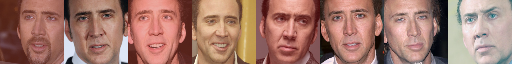

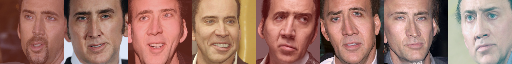

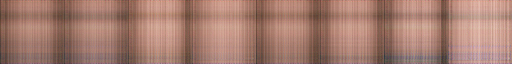

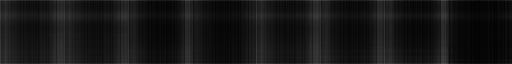

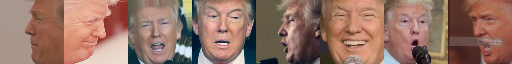

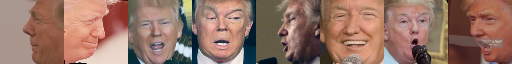

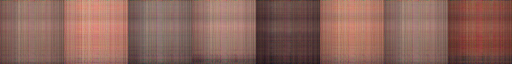

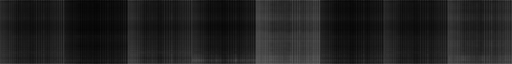

display result epoch: 5


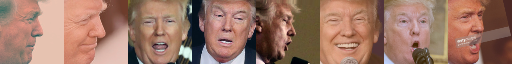

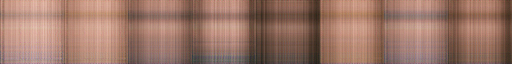

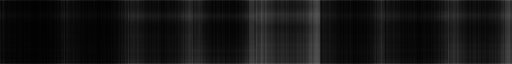

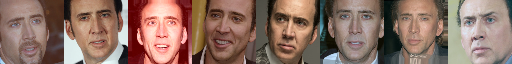

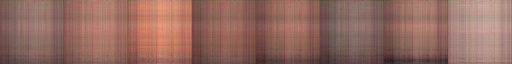

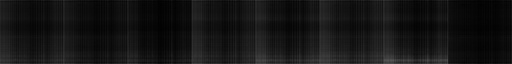

loss_D_A: 0.0925845131278038
loss_D_B: 0.08960132300853729
loss_G_A: 0.2191750705242157
loss_G_B: 0.24109813570976257
loss_G_adversarial_A: 0.09079019725322723
loss_G_reconstruction_A: 0.12743689119815826
loss_G_mask_A: 0.0009479774162173271
loss_G_adversarial_B: 0.09004439413547516
loss_G_reconstruction_B: 0.14998792111873627
loss_G_mask_B: 0.001065825461409986
epoch:6 reconstruction result


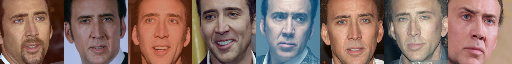

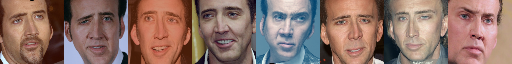

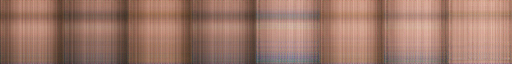

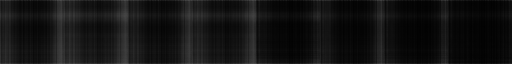

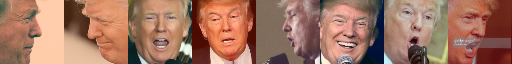

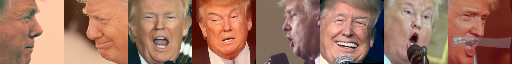

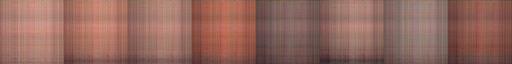

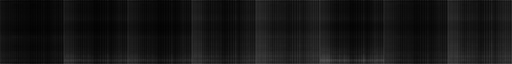

display result epoch: 6


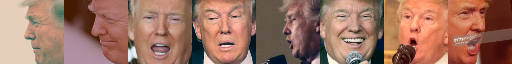

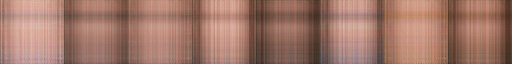

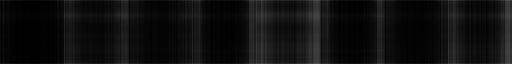

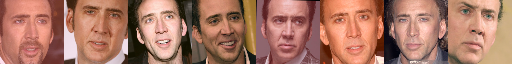

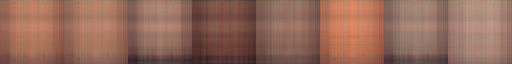

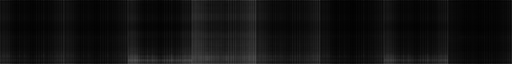

loss_D_A: 0.09065385162830353
loss_D_B: 0.08803842961788177
loss_G_A: 0.2289293259382248
loss_G_B: 0.2221543788909912
loss_G_adversarial_A: 0.08893795311450958
loss_G_reconstruction_A: 0.1392478197813034
loss_G_mask_A: 0.0007435512379743159
loss_G_adversarial_B: 0.08828409761190414
loss_G_reconstruction_B: 0.1329851895570755
loss_G_mask_B: 0.0008851031889207661
epoch:7 reconstruction result


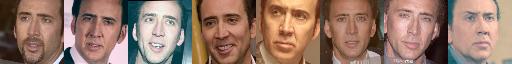

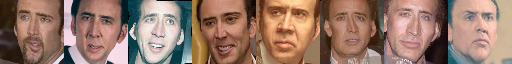

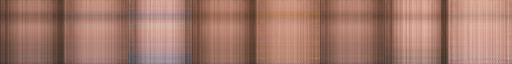

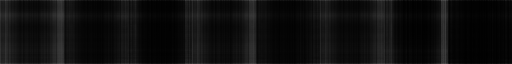

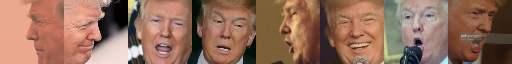

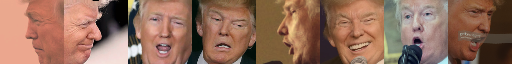

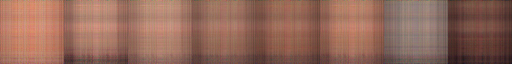

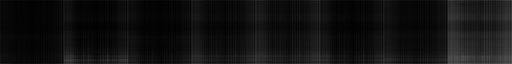

display result epoch: 7


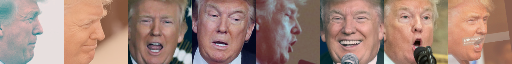

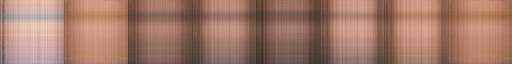

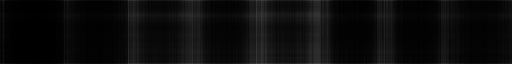

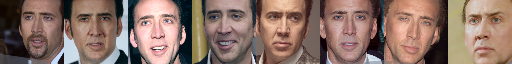

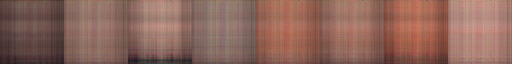

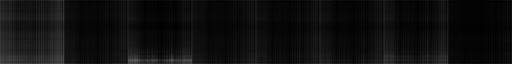

loss_D_A: 0.08880367875099182
loss_D_B: 0.08652163296937943
loss_G_A: 0.2166534811258316
loss_G_B: 0.23283709585666656
loss_G_adversarial_A: 0.08713455498218536
loss_G_reconstruction_A: 0.12894104421138763
loss_G_mask_A: 0.0005778844351880252
loss_G_adversarial_B: 0.08656405657529831
loss_G_reconstruction_B: 0.14550676941871643
loss_G_mask_B: 0.0007662620046176016
epoch:8 reconstruction result


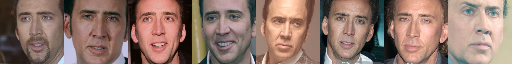

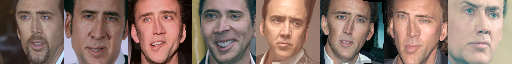

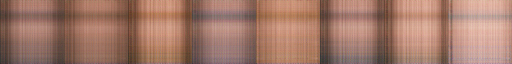

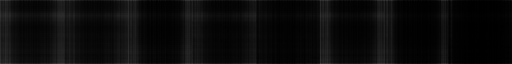

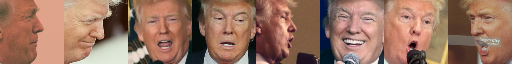

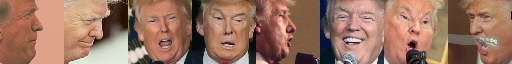

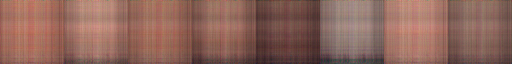

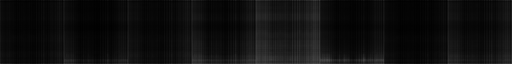

display result epoch: 8


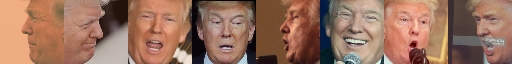

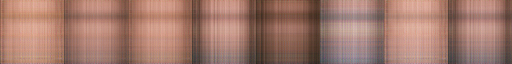

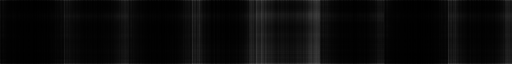

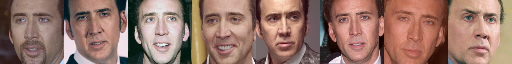

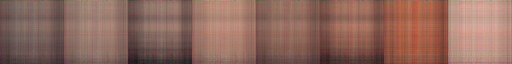

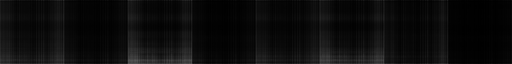

loss_D_A: 0.08703633397817612
loss_D_B: 0.08504994213581085
loss_G_A: 0.20683671534061432
loss_G_B: 0.21793809533119202
loss_G_adversarial_A: 0.08538099378347397
loss_G_reconstruction_A: 0.12095392495393753
loss_G_mask_A: 0.0005017895600758493
loss_G_adversarial_B: 0.0848843976855278
loss_G_reconstruction_B: 0.13237814605236053
loss_G_mask_B: 0.0006755630602128804
epoch:9 reconstruction result


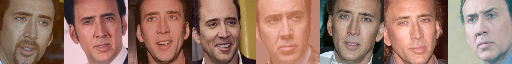

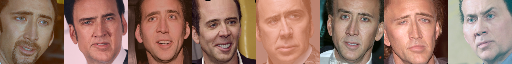

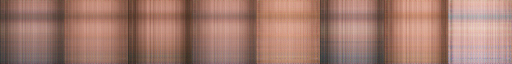

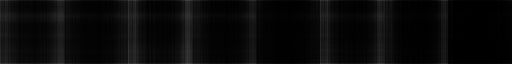

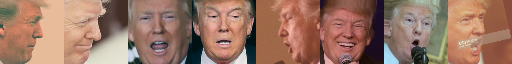

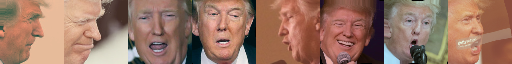

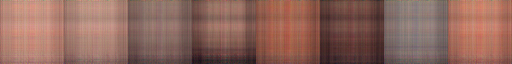

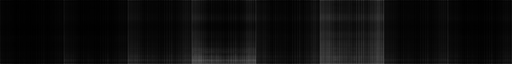

display result epoch: 9


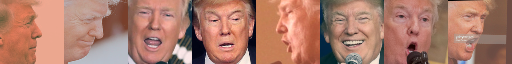

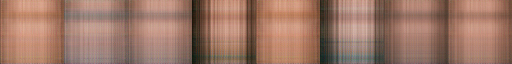

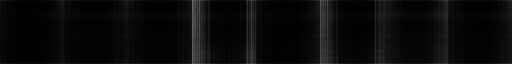

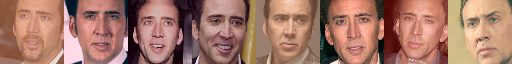

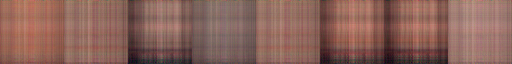

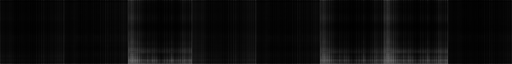

loss_D_A: 0.08534196019172668
loss_D_B: 0.08362241834402084
loss_G_A: 0.19693948328495026
loss_G_B: 0.2082795351743698
loss_G_adversarial_A: 0.08367246389389038
loss_G_reconstruction_A: 0.11271927505731583
loss_G_mask_A: 0.0005477545200847089
loss_G_adversarial_B: 0.08324258029460907
loss_G_reconstruction_B: 0.12447994947433472
loss_G_mask_B: 0.000557002320419997
epoch:10 reconstruction result


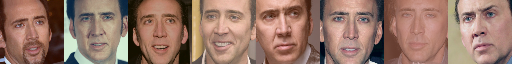

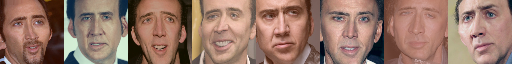

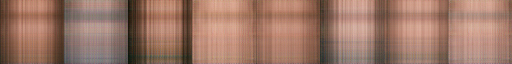

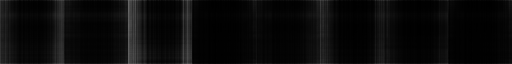

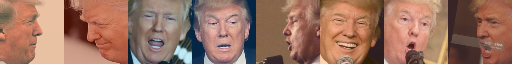

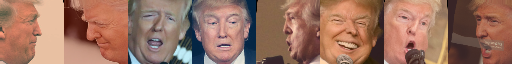

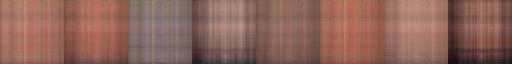

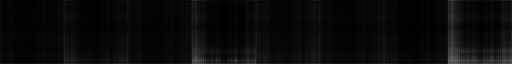

display result epoch: 10


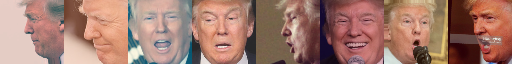

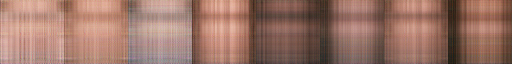

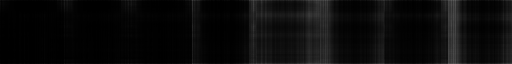

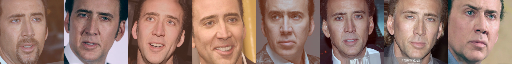

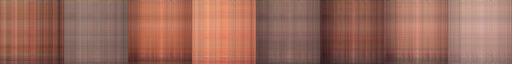

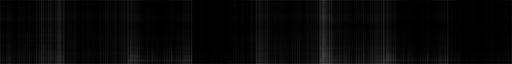

loss_D_A: 0.08371908962726593
loss_D_B: 0.08223816007375717
loss_G_A: 0.21032534539699554
loss_G_B: 0.2082921713590622
loss_G_adversarial_A: 0.08200817555189133
loss_G_reconstruction_A: 0.12785358726978302
loss_G_mask_A: 0.00046359089901670814
loss_G_adversarial_B: 0.08163797110319138
loss_G_reconstruction_B: 0.1261824667453766
loss_G_mask_B: 0.00047173179336823523
epoch:11 reconstruction result


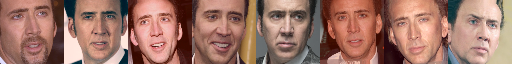

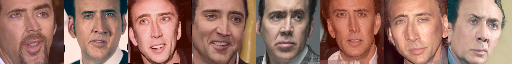

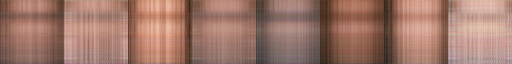

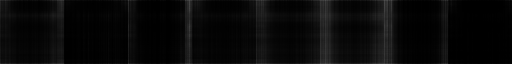

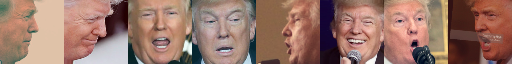

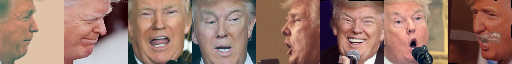

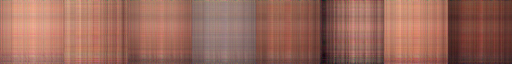

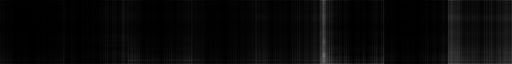

display result epoch: 11


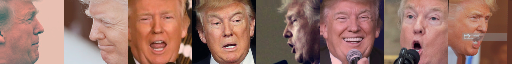

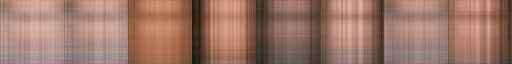

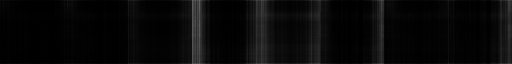

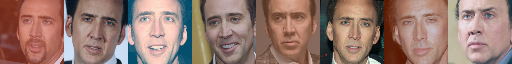

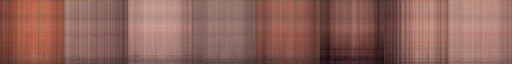

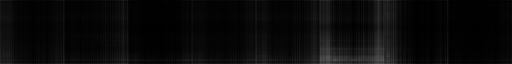

loss_D_A: 0.08216746896505356
loss_D_B: 0.08089625090360641
loss_G_A: 0.19410325586795807
loss_G_B: 0.20734182000160217
loss_G_adversarial_A: 0.08038783073425293
loss_G_reconstruction_A: 0.11326626688241959
loss_G_mask_A: 0.0004491677100304514
loss_G_adversarial_B: 0.08007003366947174
loss_G_reconstruction_B: 0.12674961984157562
loss_G_mask_B: 0.000522160844411701
epoch:12 reconstruction result


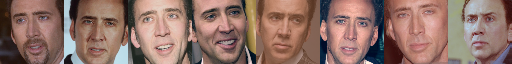

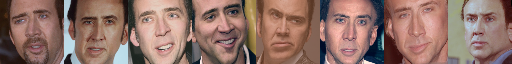

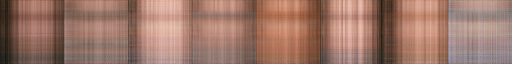

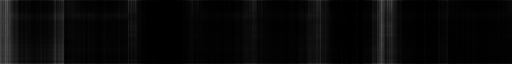

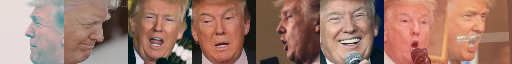

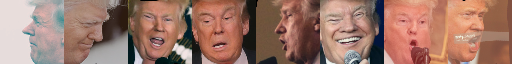

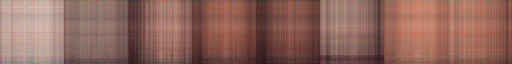

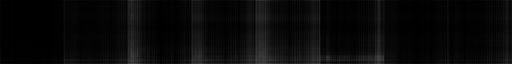

display result epoch: 12


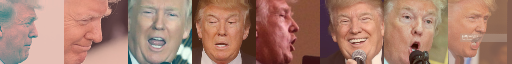

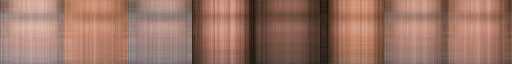

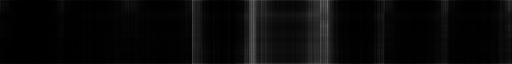

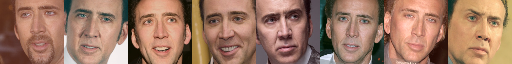

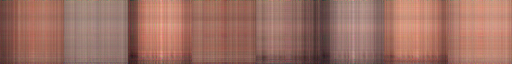

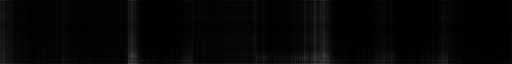

loss_D_A: 0.08068009465932846
loss_D_B: 0.07959581166505814
loss_G_A: 0.19903495907783508
loss_G_B: 0.191153421998024
loss_G_adversarial_A: 0.07880809158086777
loss_G_reconstruction_A: 0.11978308111429214
loss_G_mask_A: 0.0004437836760189384
loss_G_adversarial_B: 0.07853701710700989
loss_G_reconstruction_B: 0.11231758445501328
loss_G_mask_B: 0.00029880570946261287
epoch:13 reconstruction result


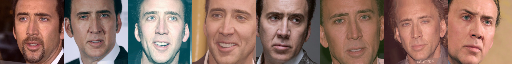

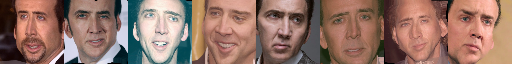

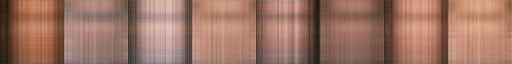

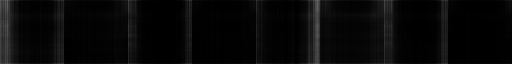

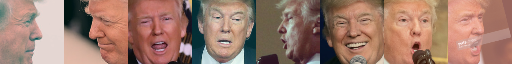

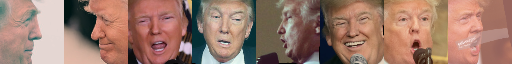

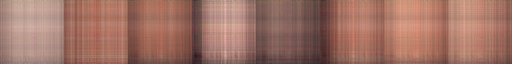

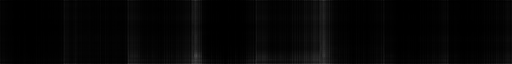

display result epoch: 13


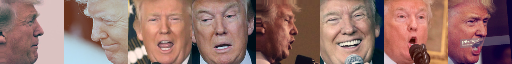

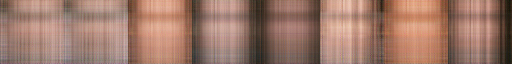

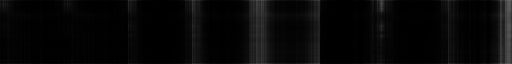

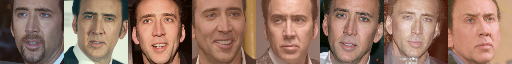

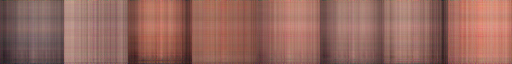

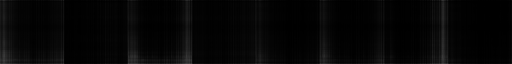

loss_D_A: 0.07925408333539963
loss_D_B: 0.0783359557390213
loss_G_A: 0.18734495341777802
loss_G_B: 0.1897328495979309
loss_G_adversarial_A: 0.07726746052503586
loss_G_reconstruction_A: 0.10968049615621567
loss_G_mask_A: 0.00039699970511719584
loss_G_adversarial_B: 0.07703795284032822
loss_G_reconstruction_B: 0.11231481283903122
loss_G_mask_B: 0.00038007862167432904
epoch:14 reconstruction result


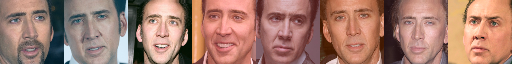

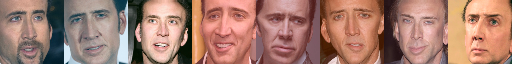

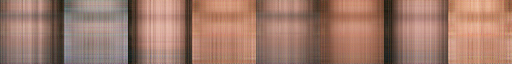

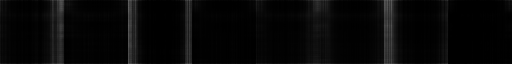

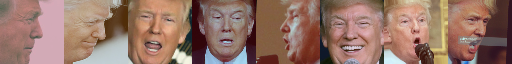

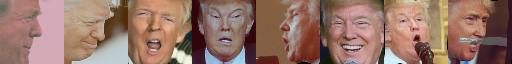

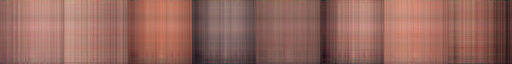

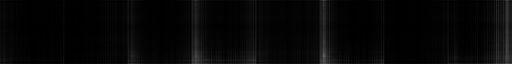

display result epoch: 14


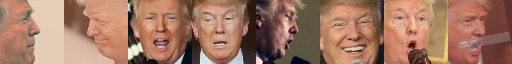

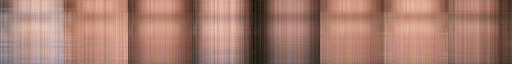

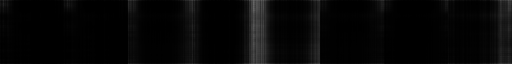

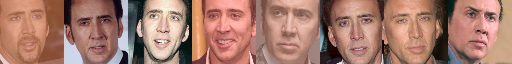

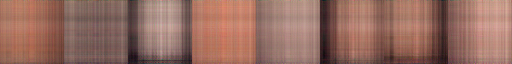

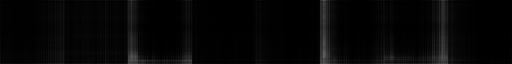

loss_D_A: 0.07789462059736252
loss_D_B: 0.07711583375930786
loss_G_A: 0.19718611240386963
loss_G_B: 0.1875869482755661
loss_G_adversarial_A: 0.075768381357193
loss_G_reconstruction_A: 0.12110207229852676
loss_G_mask_A: 0.00031566410325467587
loss_G_adversarial_B: 0.07557368278503418
loss_G_reconstruction_B: 0.11167465895414352
loss_G_mask_B: 0.00033859204268082976
epoch:15 reconstruction result


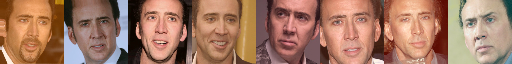

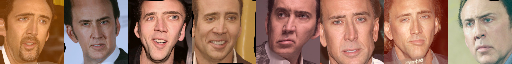

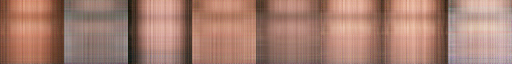

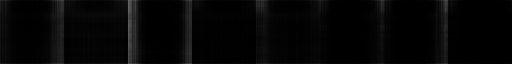

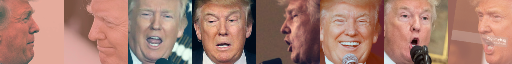

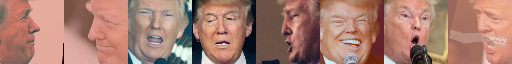

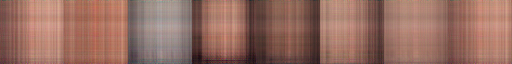

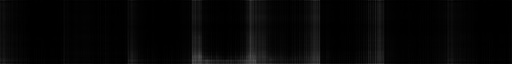

display result epoch: 15


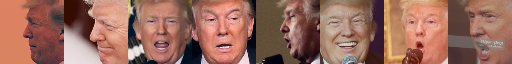

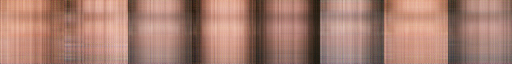

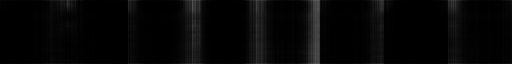

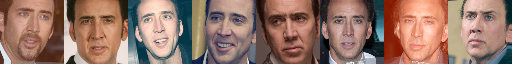

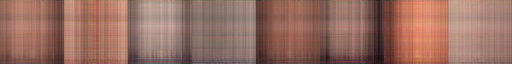

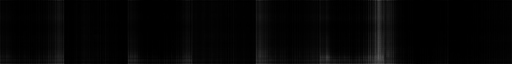

loss_D_A: 0.07658853381872177
loss_D_B: 0.07593460381031036
loss_G_A: 0.208413764834404
loss_G_B: 0.18741680681705475
loss_G_adversarial_A: 0.07430439442396164
loss_G_reconstruction_A: 0.13381606340408325
loss_G_mask_A: 0.00029329422977752984
loss_G_adversarial_B: 0.07414091378450394
loss_G_reconstruction_B: 0.11295431852340698
loss_G_mask_B: 0.000321581814205274
epoch:16 reconstruction result


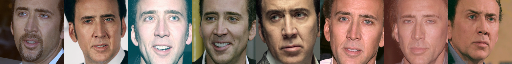

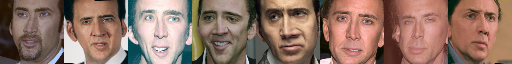

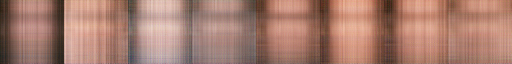

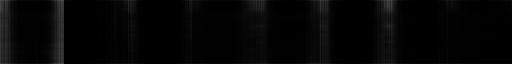

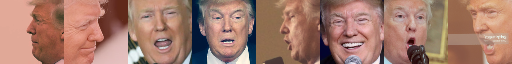

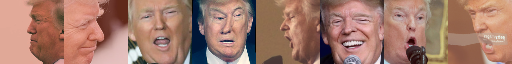

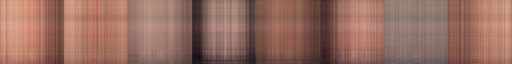

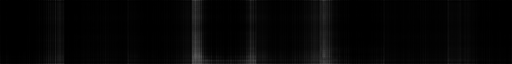

display result epoch: 16


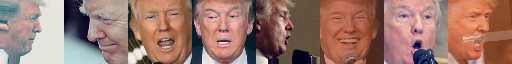

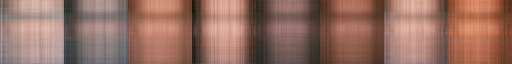

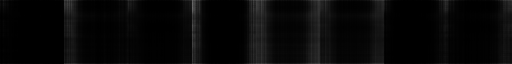

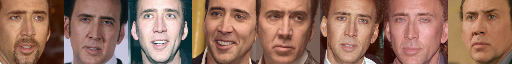

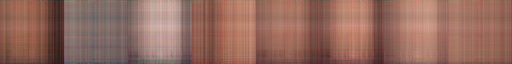

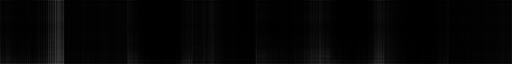

loss_D_A: 0.07533735036849976
loss_D_B: 0.07479140907526016
loss_G_A: 0.17701789736747742
loss_G_B: 0.18856669962406158
loss_G_adversarial_A: 0.0728762075304985
loss_G_reconstruction_A: 0.10370516031980515
loss_G_mask_A: 0.00043653472675941885
loss_G_adversarial_B: 0.07273972034454346
loss_G_reconstruction_B: 0.11548129469156265
loss_G_mask_B: 0.0003456973936408758
epoch:17 reconstruction result


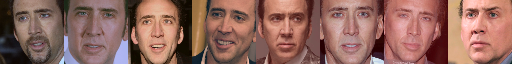

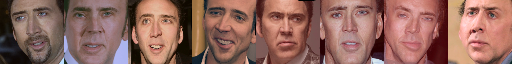

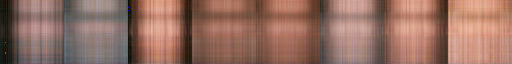

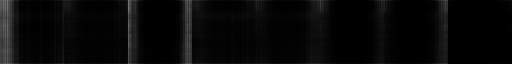

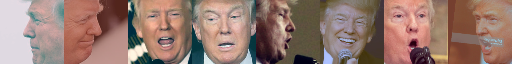

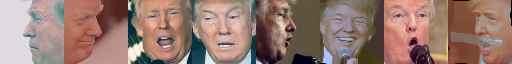

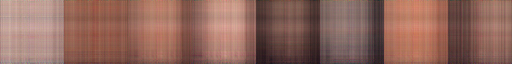

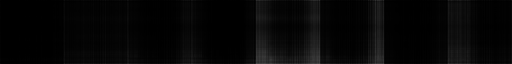

display result epoch: 17


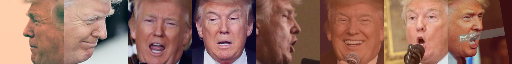

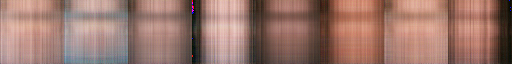

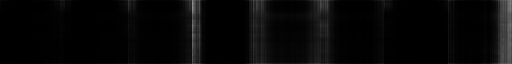

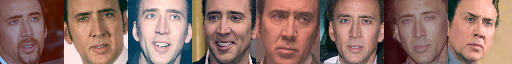

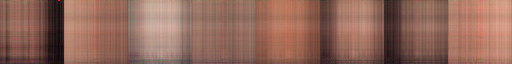

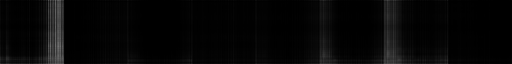

loss_D_A: 0.07413852959871292
loss_D_B: 0.07368548959493637
loss_G_A: 0.18481481075286865
loss_G_B: 0.1868804395198822
loss_G_adversarial_A: 0.07148253917694092
loss_G_reconstruction_A: 0.11298545449972153
loss_G_mask_A: 0.000346803804859519
loss_G_adversarial_B: 0.07136928290128708
loss_G_reconstruction_B: 0.11520280689001083
loss_G_mask_B: 0.00030835269717499614
epoch:18 reconstruction result


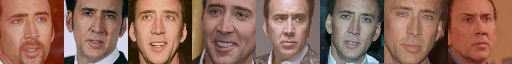

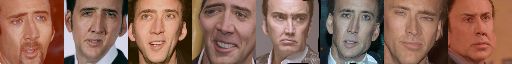

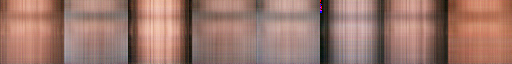

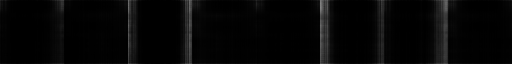

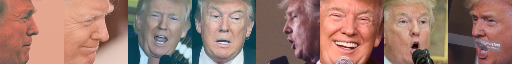

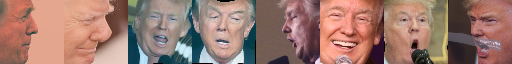

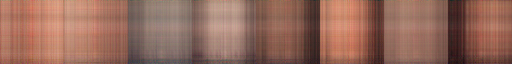

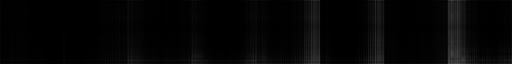

display result epoch: 18


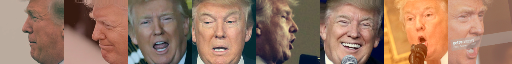

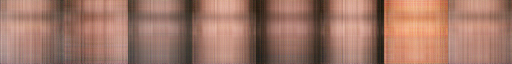

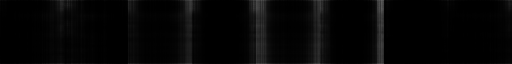

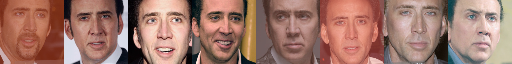

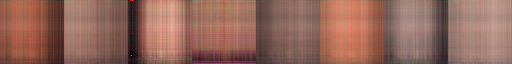

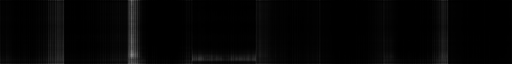

loss_D_A: 0.07298963516950607
loss_D_B: 0.07261600345373154
loss_G_A: 0.18124549090862274
loss_G_B: 0.18978731334209442
loss_G_adversarial_A: 0.07012218981981277
loss_G_reconstruction_A: 0.11082852631807327
loss_G_mask_A: 0.00029478181386366487
loss_G_adversarial_B: 0.07002877444028854
loss_G_reconstruction_B: 0.11946288496255875
loss_G_mask_B: 0.0002956585958600044
epoch:19 reconstruction result


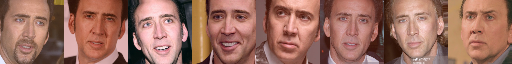

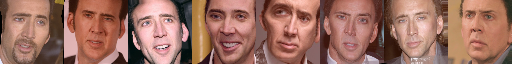

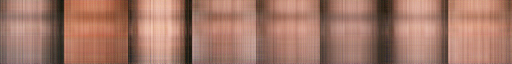

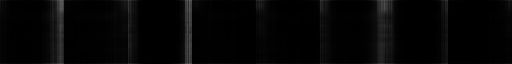

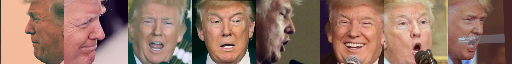

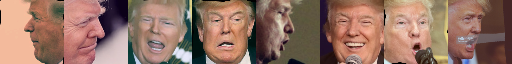

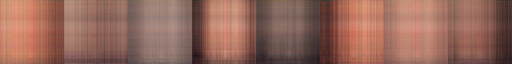

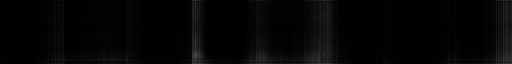

display result epoch: 19


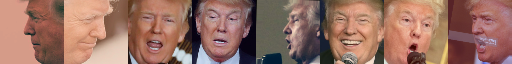

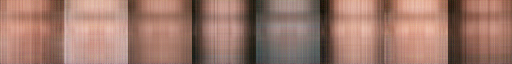

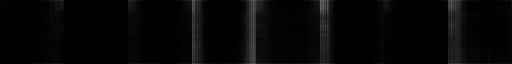

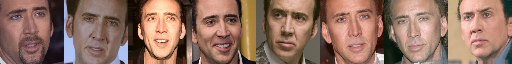

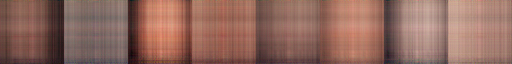

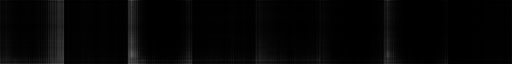

loss_D_A: 0.07188834995031357
loss_D_B: 0.07158217579126358
loss_G_A: 0.1775519698858261
loss_G_B: 0.17255137860774994
loss_G_adversarial_A: 0.06879397481679916
loss_G_reconstruction_A: 0.10843636840581894
loss_G_mask_A: 0.0003216300392523408
loss_G_adversarial_B: 0.06871742755174637
loss_G_reconstruction_B: 0.10359736531972885
loss_G_mask_B: 0.00023658215650357306
epoch:20 reconstruction result


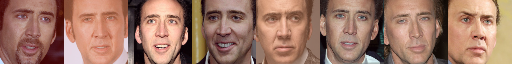

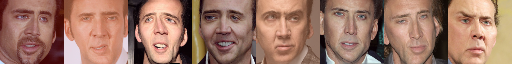

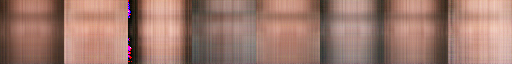

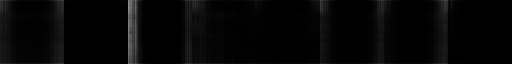

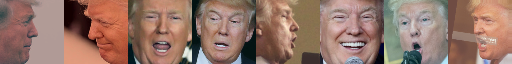

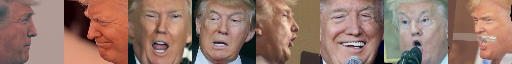

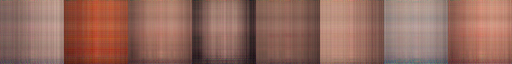

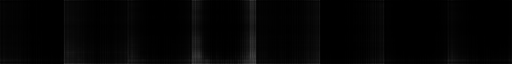

display result epoch: 20


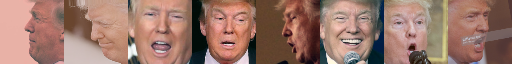

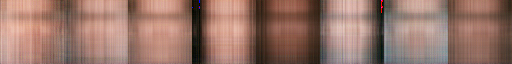

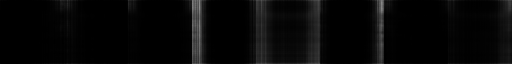

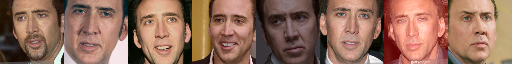

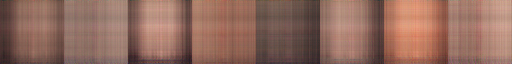

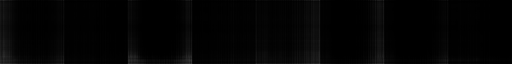

loss_D_A: 0.07083249092102051
loss_D_B: 0.07058323919773102
loss_G_A: 0.18279708921909332
loss_G_B: 0.16088822484016418
loss_G_adversarial_A: 0.06749679893255234
loss_G_reconstruction_A: 0.11498341709375381
loss_G_mask_A: 0.00031686818692833185
loss_G_adversarial_B: 0.06743448227643967
loss_G_reconstruction_B: 0.09325098991394043
loss_G_mask_B: 0.00020275007409509271
epoch:21 reconstruction result


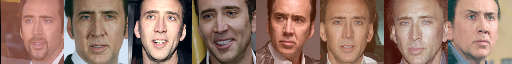

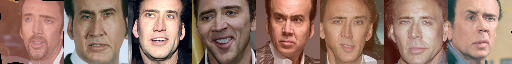

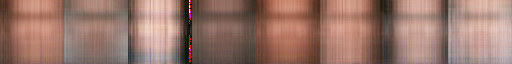

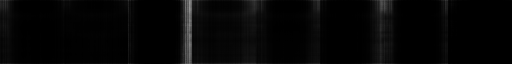

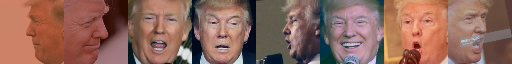

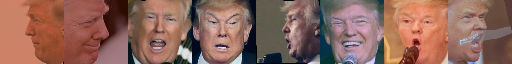

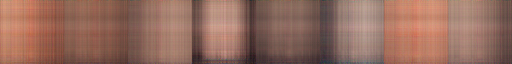

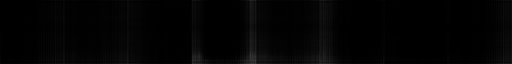

display result epoch: 21


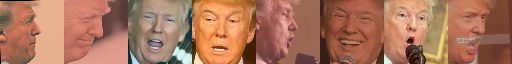

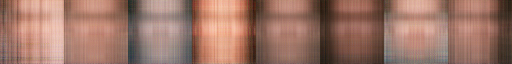

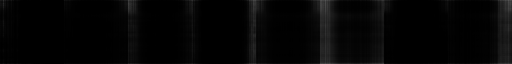

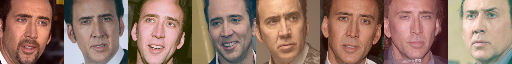

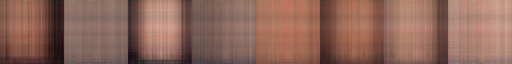

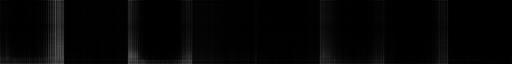

loss_D_A: 0.06981994211673737
loss_D_B: 0.06961840391159058
loss_G_A: 0.16954027116298676
loss_G_B: 0.1815752238035202
loss_G_adversarial_A: 0.06622961908578873
loss_G_reconstruction_A: 0.10298418253660202
loss_G_mask_A: 0.0003264667757321149
loss_G_adversarial_B: 0.06617923825979233
loss_G_reconstruction_B: 0.11507973074913025
loss_G_mask_B: 0.0003162469365634024
epoch:22 reconstruction result


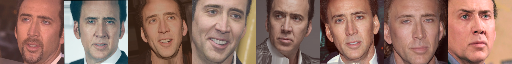

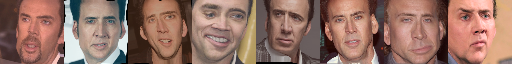

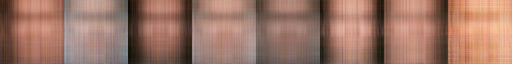

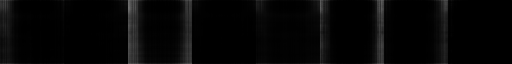

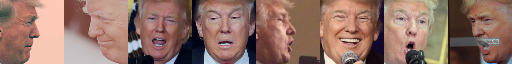

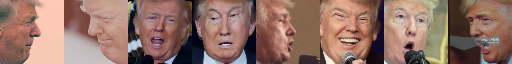

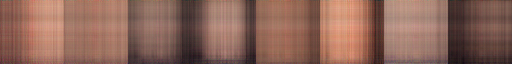

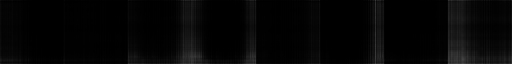

display result epoch: 22


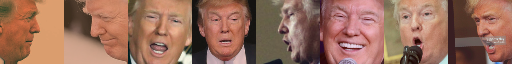

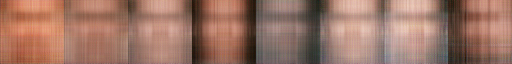

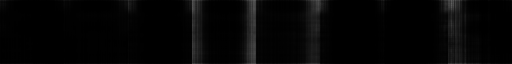

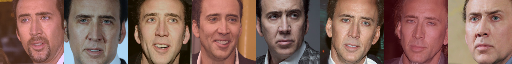

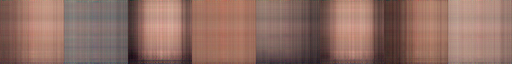

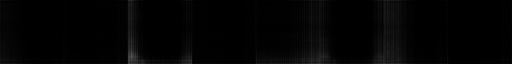

loss_D_A: 0.06884875893592834
loss_D_B: 0.06868695467710495
loss_G_A: 0.17770563066005707
loss_G_B: 0.17359845340251923
loss_G_adversarial_A: 0.06499148905277252
loss_G_reconstruction_A: 0.11249736696481705
loss_G_mask_A: 0.00021676041069440544
loss_G_adversarial_B: 0.06495103985071182
loss_G_reconstruction_B: 0.1083868145942688
loss_G_mask_B: 0.0002606030029710382
epoch:23 reconstruction result


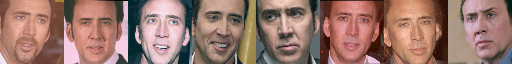

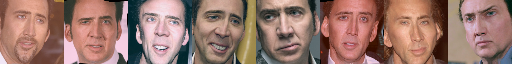

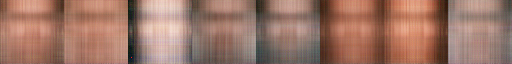

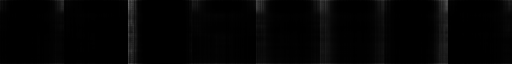

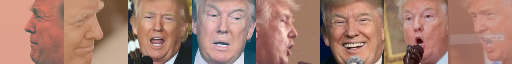

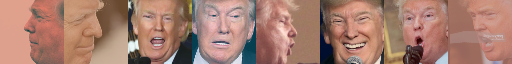

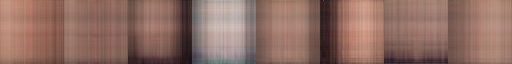

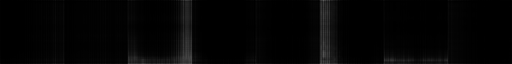

display result epoch: 23


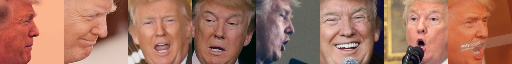

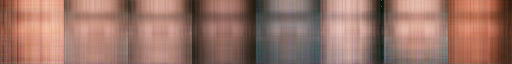

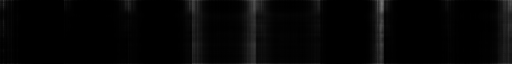

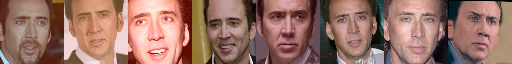

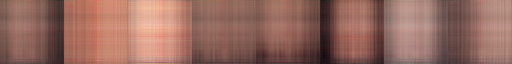

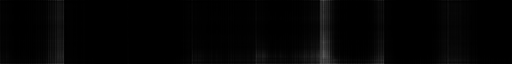

loss_D_A: 0.067917101085186
loss_D_B: 0.06778813153505325
loss_G_A: 0.1655312478542328
loss_G_B: 0.1664087474346161
loss_G_adversarial_A: 0.06378147006034851
loss_G_reconstruction_A: 0.10141997784376144
loss_G_mask_A: 0.00032979549723677337
loss_G_adversarial_B: 0.06374922394752502
loss_G_reconstruction_B: 0.1024649515748024
loss_G_mask_B: 0.00019458205497357994
epoch:24 reconstruction result


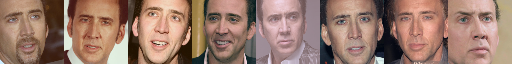

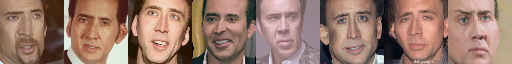

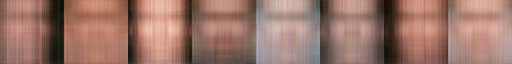

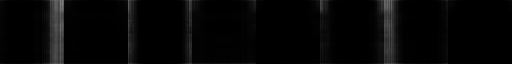

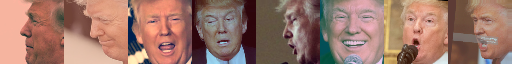

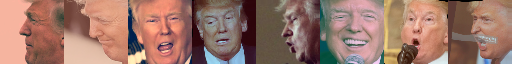

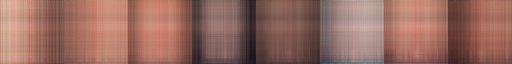

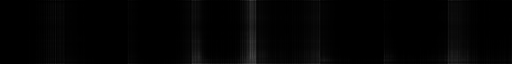

display result epoch: 24


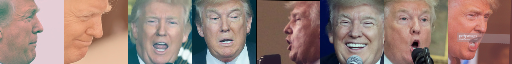

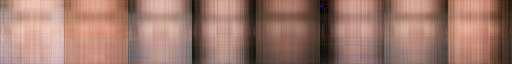

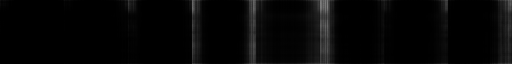

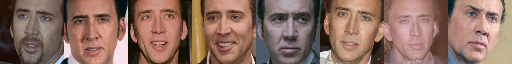

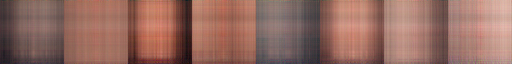

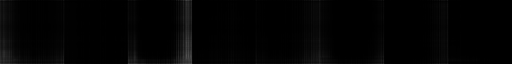

loss_D_A: 0.06702323257923126
loss_D_B: 0.0669211894273758
loss_G_A: 0.16044501960277557
loss_G_B: 0.16128310561180115
loss_G_adversarial_A: 0.06259872019290924
loss_G_reconstruction_A: 0.09754889458417892
loss_G_mask_A: 0.0002974195231217891
loss_G_adversarial_B: 0.06257320940494537
loss_G_reconstruction_B: 0.09851589053869247
loss_G_mask_B: 0.00019401741155888885
epoch:25 reconstruction result


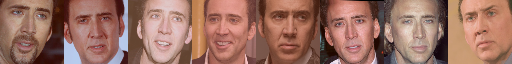

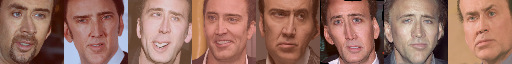

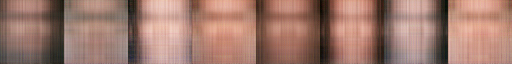

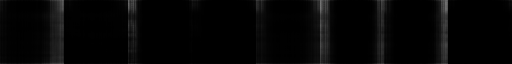

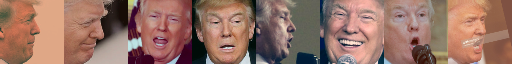

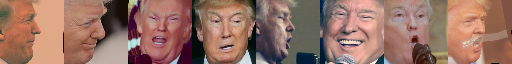

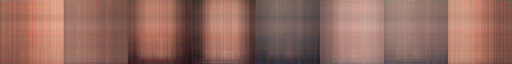

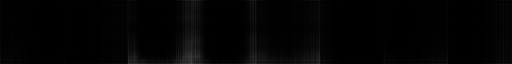

display result epoch: 25


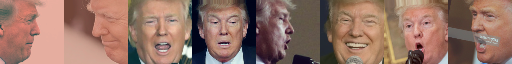

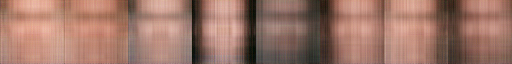

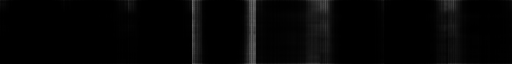

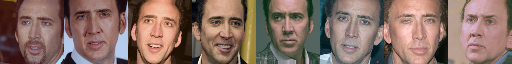

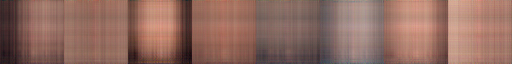

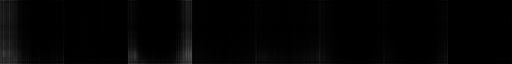

loss_D_A: 0.06616554409265518
loss_D_B: 0.06608543545007706
loss_G_A: 0.19251292943954468
loss_G_B: 0.18025700747966766
loss_G_adversarial_A: 0.06144246086478233
loss_G_reconstruction_A: 0.13083454966545105
loss_G_mask_A: 0.0002359185746172443
loss_G_adversarial_B: 0.0614224337041378
loss_G_reconstruction_B: 0.11861463636159897
loss_G_mask_B: 0.00021993921836838126
epoch:26 reconstruction result


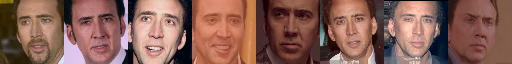

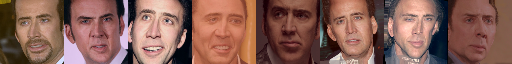

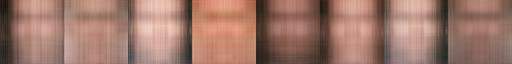

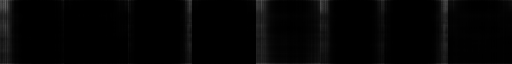

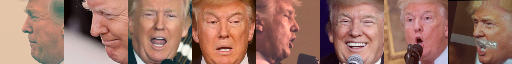

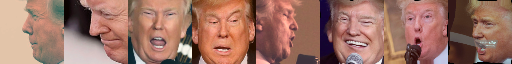

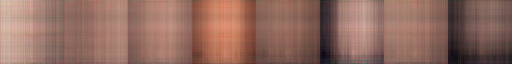

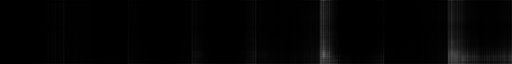

display result epoch: 26


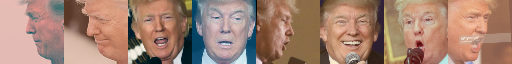

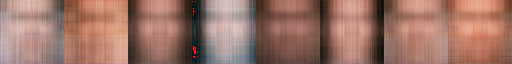

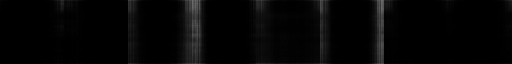

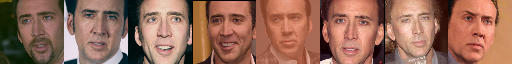

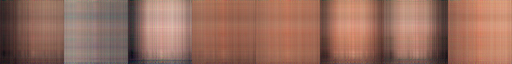

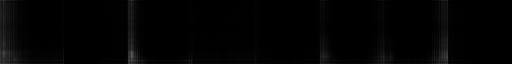

loss_D_A: 0.06534256041049957
loss_D_B: 0.06528014689683914
loss_G_A: 0.1716080605983734
loss_G_B: 0.15514391660690308
loss_G_adversarial_A: 0.06031196191906929
loss_G_reconstruction_A: 0.11098980903625488
loss_G_mask_A: 0.0003062986652366817
loss_G_adversarial_B: 0.06029635667800903
loss_G_reconstruction_B: 0.09463777393102646
loss_G_mask_B: 0.00020977616077288985
epoch:27 reconstruction result


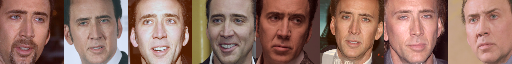

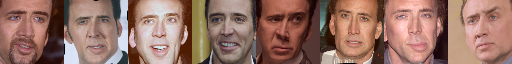

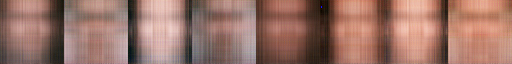

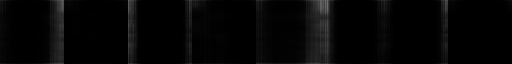

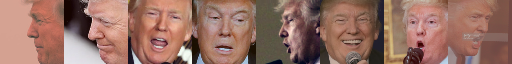

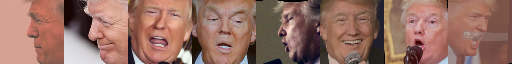

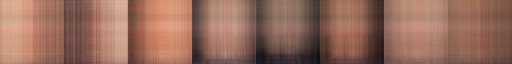

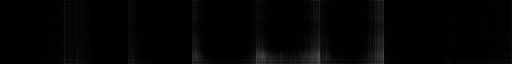

display result epoch: 27


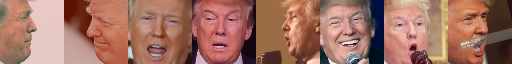

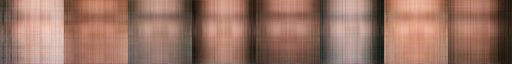

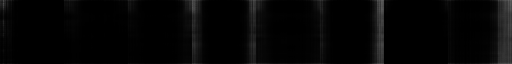

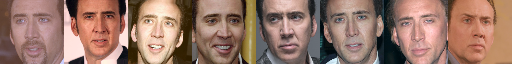

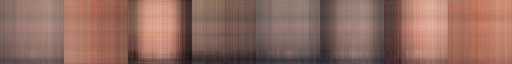

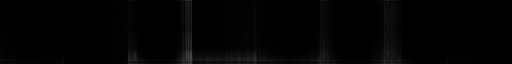

loss_D_A: 0.06455285102128983
loss_D_B: 0.06450461596250534
loss_G_A: 0.15891943871974945
loss_G_B: 0.1647980958223343
loss_G_adversarial_A: 0.059206534177064896
loss_G_reconstruction_A: 0.09942223876714706
loss_G_mask_A: 0.00029066039132885635
loss_G_adversarial_B: 0.05919448286294937
loss_G_reconstruction_B: 0.10537806898355484
loss_G_mask_B: 0.00022553726739715785
epoch:28 reconstruction result


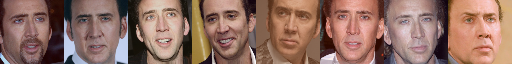

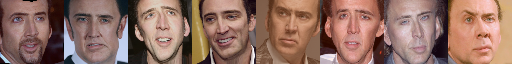

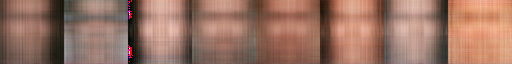

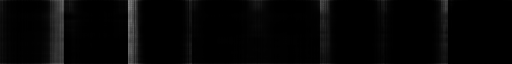

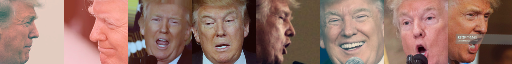

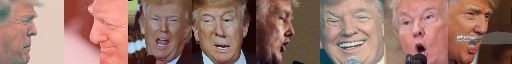

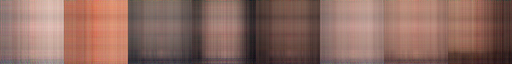

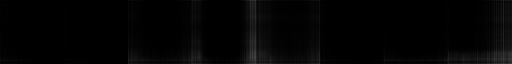

display result epoch: 28


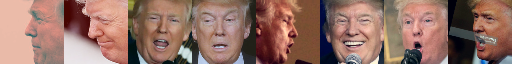

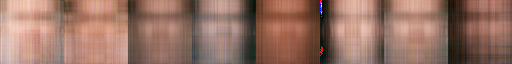

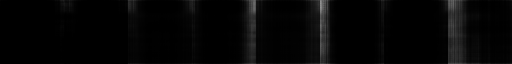

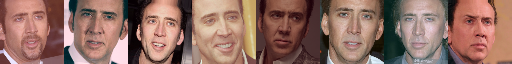

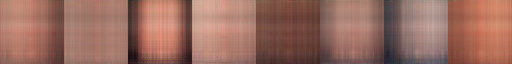

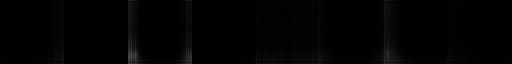

loss_D_A: 0.06379513442516327
loss_D_B: 0.06375817954540253
loss_G_A: 0.16937872767448425
loss_G_B: 0.16612201929092407
loss_G_adversarial_A: 0.0581255741417408
loss_G_reconstruction_A: 0.11106475442647934
loss_G_mask_A: 0.00018839692347683012
loss_G_adversarial_B: 0.05811633542180061
loss_G_reconstruction_B: 0.10785302519798279
loss_G_mask_B: 0.00015266804257407784
epoch:29 reconstruction result


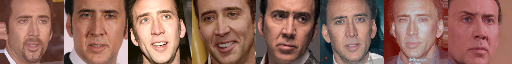

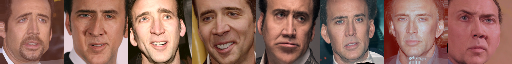

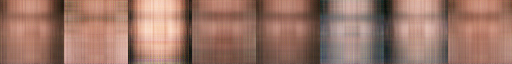

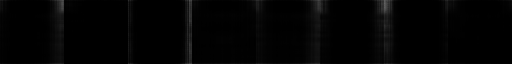

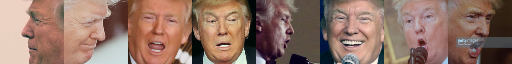

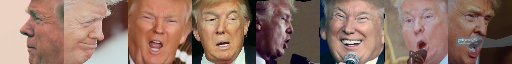

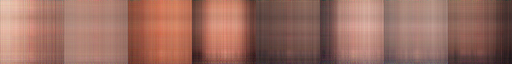

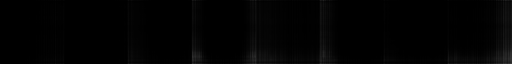

display result epoch: 29


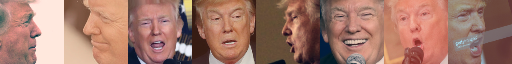

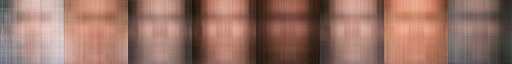

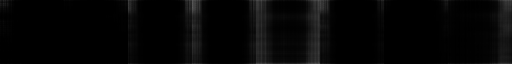

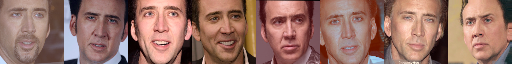

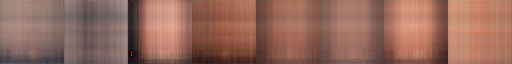

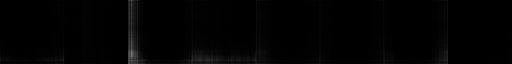

loss_D_A: 0.06306818872690201
loss_D_B: 0.0630401074886322
loss_G_A: 0.16135725378990173
loss_G_B: 0.18820948898792267
loss_G_adversarial_A: 0.05706849694252014
loss_G_reconstruction_A: 0.10400592535734177
loss_G_mask_A: 0.00028282534913159907
loss_G_adversarial_B: 0.05706147477030754
loss_G_reconstruction_B: 0.1309577226638794
loss_G_mask_B: 0.0001902837975649163
epoch:30 reconstruction result


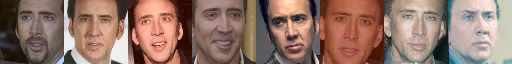

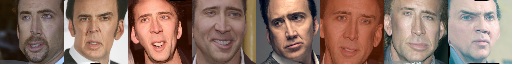

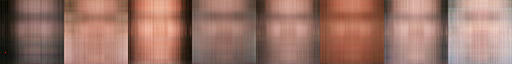

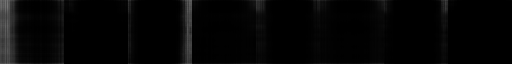

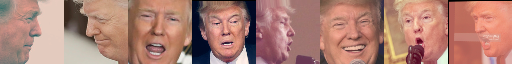

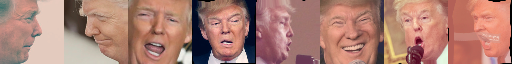

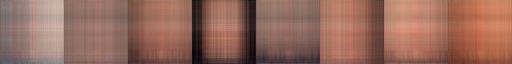

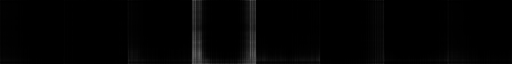

display result epoch: 30


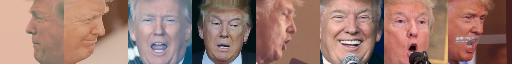

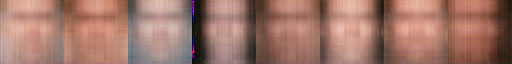

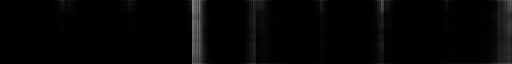

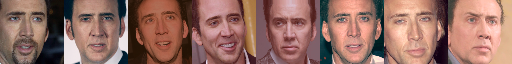

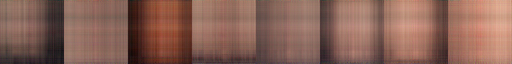

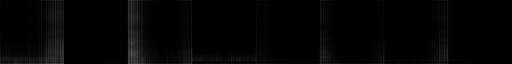

loss_D_A: 0.06237092241644859
loss_D_B: 0.06234976649284363
loss_G_A: 0.16584262251853943
loss_G_B: 0.18433813750743866
loss_G_adversarial_A: 0.056034769862890244
loss_G_reconstruction_A: 0.10956571251153946
loss_G_mask_A: 0.000242149195400998
loss_G_adversarial_B: 0.05602947622537613
loss_G_reconstruction_B: 0.12812328338623047
loss_G_mask_B: 0.00018538035510573536
epoch:31 reconstruction result


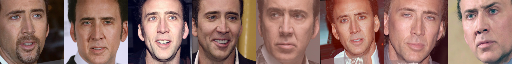

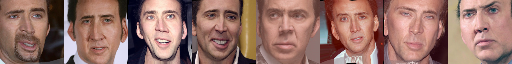

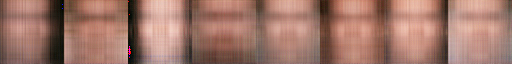

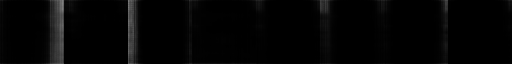

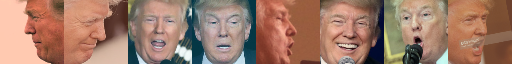

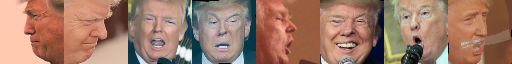

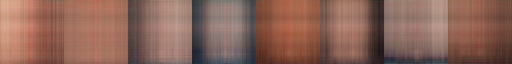

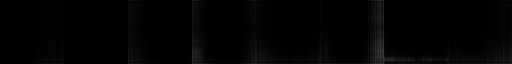

display result epoch: 31


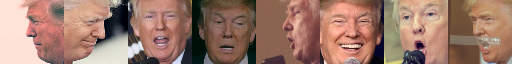

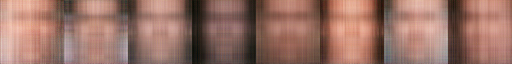

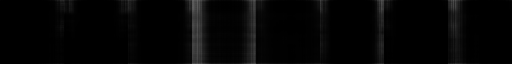

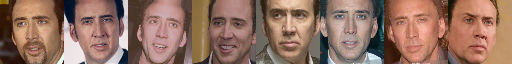

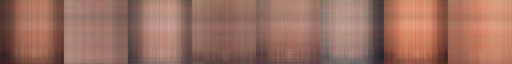

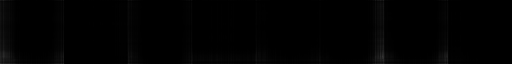

loss_D_A: 0.06170226261019707
loss_D_B: 0.06168646365404129
loss_G_A: 0.1571982055902481
loss_G_B: 0.16593098640441895
loss_G_adversarial_A: 0.055023908615112305
loss_G_reconstruction_A: 0.1019102931022644
loss_G_mask_A: 0.00026401091599836946
loss_G_adversarial_B: 0.05501995608210564
loss_G_reconstruction_B: 0.11078816652297974
loss_G_mask_B: 0.00012285387492738664
epoch:32 reconstruction result


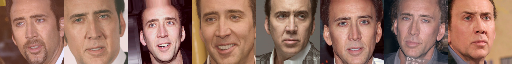

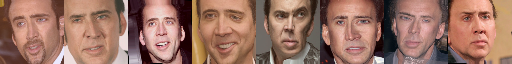

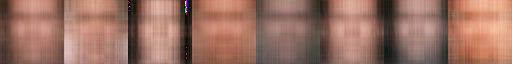

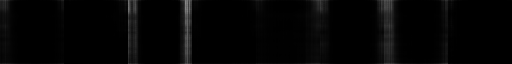

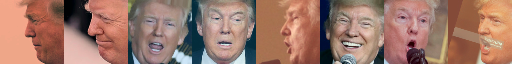

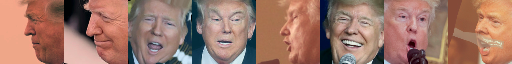

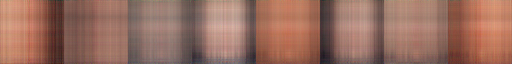

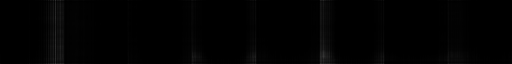

display result epoch: 32


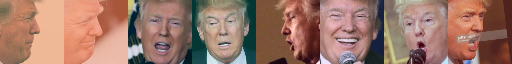

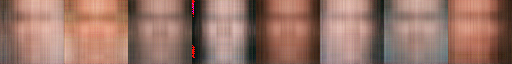

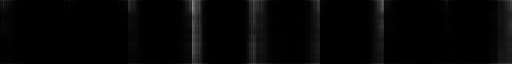

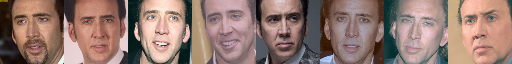

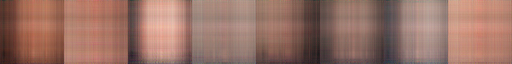

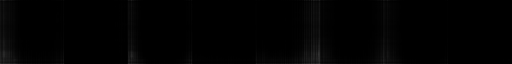

loss_D_A: 0.06106124445796013
loss_D_B: 0.061049558222293854
loss_G_A: 0.15935389697551727
loss_G_B: 0.15801025927066803
loss_G_adversarial_A: 0.05403547361493111
loss_G_reconstruction_A: 0.10499238967895508
loss_G_mask_A: 0.00032603280851617455
loss_G_adversarial_B: 0.054032545536756516
loss_G_reconstruction_B: 0.10384112596511841
loss_G_mask_B: 0.00013658626994583756
epoch:33 reconstruction result


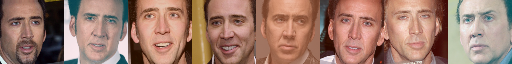

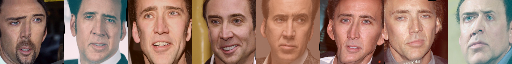

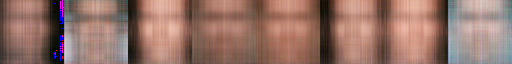

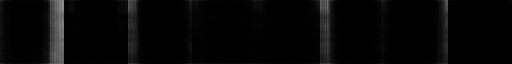

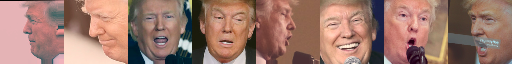

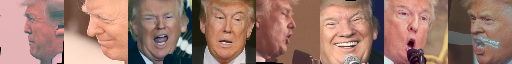

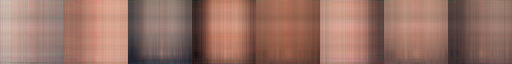

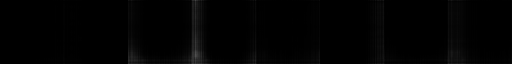

display result epoch: 33


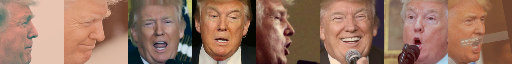

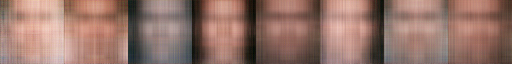

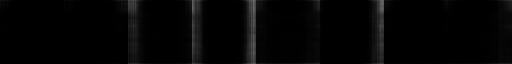

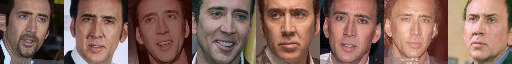

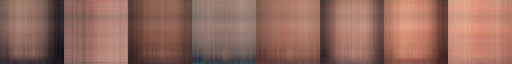

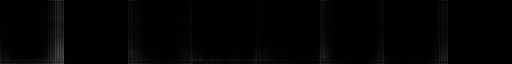

loss_D_A: 0.060446955263614655
loss_D_B: 0.060438383370637894
loss_G_A: 0.16476194560527802
loss_G_B: 0.1665848046541214
loss_G_adversarial_A: 0.05306902527809143
loss_G_reconstruction_A: 0.11146994680166245
loss_G_mask_A: 0.00022296764655038714
loss_G_adversarial_B: 0.053066886961460114
loss_G_reconstruction_B: 0.1133846864104271
loss_G_mask_B: 0.00013323342136573046
epoch:34 reconstruction result


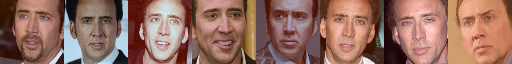

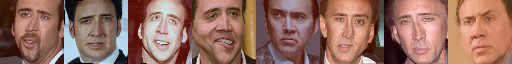

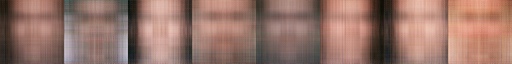

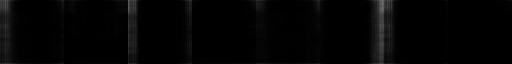

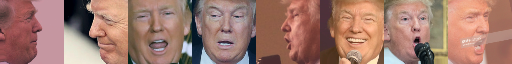

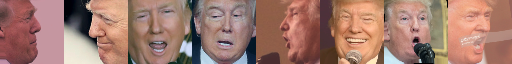

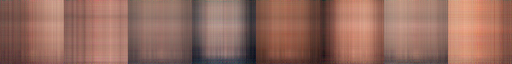

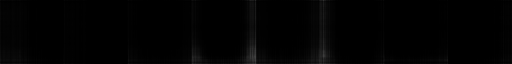

display result epoch: 34


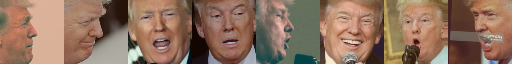

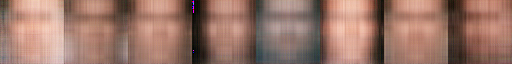

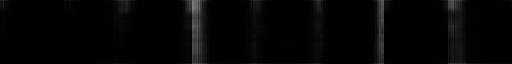

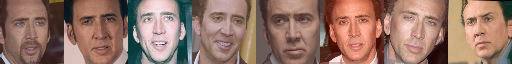

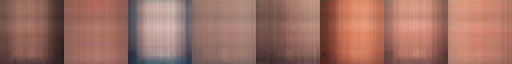

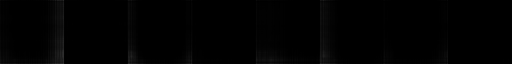

loss_D_A: 0.0598585270345211
loss_D_B: 0.059852298349142075
loss_G_A: 0.1578248292207718
loss_G_B: 0.1656709462404251
loss_G_adversarial_A: 0.052124202251434326
loss_G_reconstruction_A: 0.10546670109033585
loss_G_mask_A: 0.0002339333004783839
loss_G_adversarial_B: 0.05212264135479927
loss_G_reconstruction_B: 0.1134207472205162
loss_G_mask_B: 0.00012754861381836236
epoch:35 reconstruction result


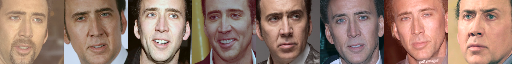

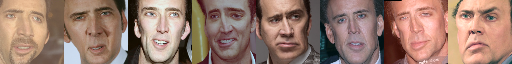

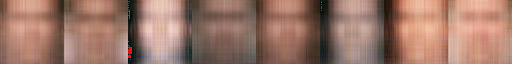

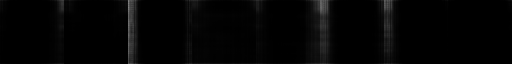

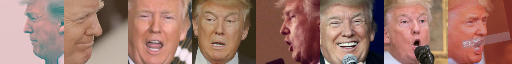

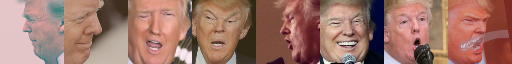

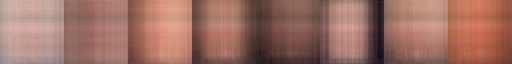

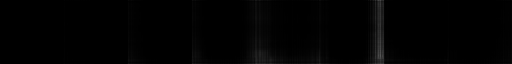

display result epoch: 35


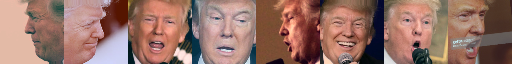

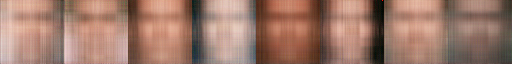

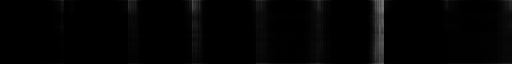

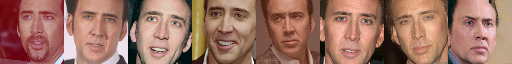

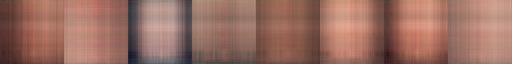

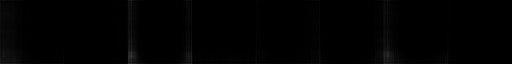

loss_D_A: 0.05929514765739441
loss_D_B: 0.059290677309036255
loss_G_A: 0.14892271161079407
loss_G_B: 0.14532092213630676
loss_G_adversarial_A: 0.05120062455534935
loss_G_reconstruction_A: 0.09754181653261185
loss_G_mask_A: 0.0001802722254069522
loss_G_adversarial_B: 0.05119950324296951
loss_G_reconstruction_B: 0.09400153160095215
loss_G_mask_B: 0.00011990064376732334
epoch:36 reconstruction result


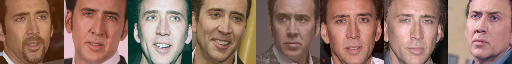

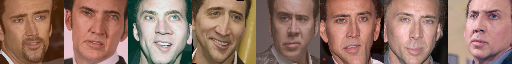

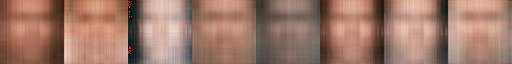

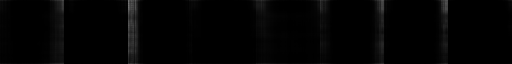

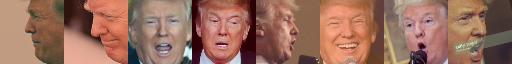

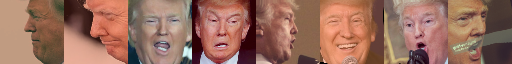

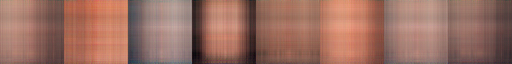

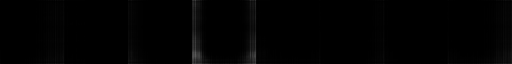

display result epoch: 36


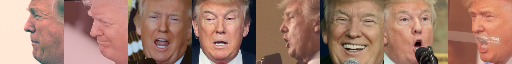

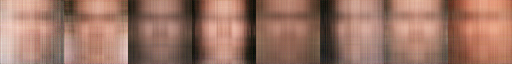

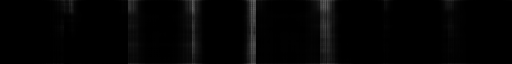

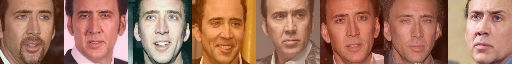

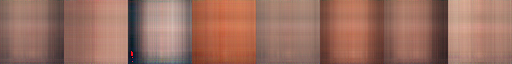

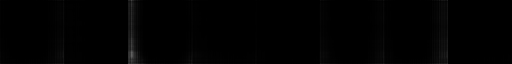

loss_D_A: 0.05875605344772339
loss_D_B: 0.0587528720498085
loss_G_A: 0.15800294280052185
loss_G_B: 0.15581963956356049
loss_G_adversarial_A: 0.05029796436429024
loss_G_reconstruction_A: 0.10747373849153519
loss_G_mask_A: 0.00023123665596358478
loss_G_adversarial_B: 0.05029716715216637
loss_G_reconstruction_B: 0.10542678833007812
loss_G_mask_B: 9.568160021444783e-05
epoch:37 reconstruction result


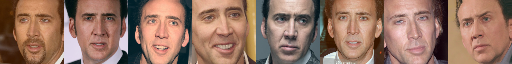

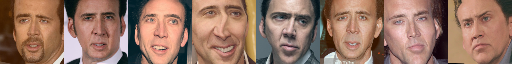

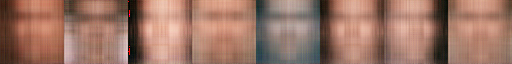

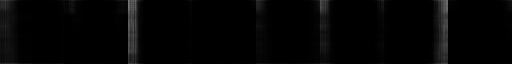

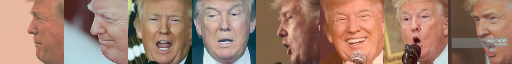

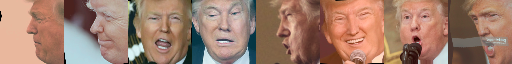

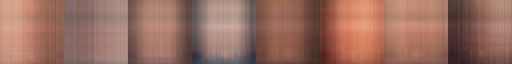

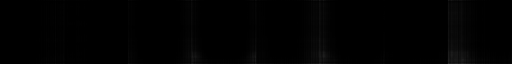

In [0]:
import imp
import network
imp.reload(network)
import loss
imp.reload(loss)
import dataset
imp.reload(dataset)
import os
import cv2
import numpy as np
from torch.utils.data import DataLoader
import torch
import vggface
from glob import glob
import imp
import visualization as vis

config = {'isTrain': True,
          'loss_config':{'pl_on': False,
                         'cyclegan_on': False,
                         'edgeloss_on': False,
                         'eyeloss_on': False,
                         'lr_factor': 1.,
                         'mask_threshold': 0.,
                              },
          'loss_weight_config': {'reconstruction_loss': 1,
                                 'adversarial_loss_discriminator': 0.1,
                                 'adversarial_loss_generator': 0.1,
                                 'cycle_consistency_loss': 0.1,
                                 'perceptual_loss': [0.03, 0.1, 0.3, 0.1],
                                 'mask_loss': 0.01,
                                 'eye_loss': 0.1,
                                 'edge_loss': 0.1,
                                },
          
          'G_lr': 0.0001,
          'D_lr': 0.0002,
          'C_lr': 0.0001,
          'batchsize': 8,
          'resize': 256,
          'epochs': 1000,
          'cycleepochs': 800,
          'display_interval': 1,
          'save_dir': './weights/',
          'save_interval': 100,
          'augmentation':{'rotate_degree': 5,
                          'flip': True,
                          'motion_blur': 0.6,
                         },
          'imagepath':['./faceA/rgb/', './faceB/rgb/'],
          'eye_mask_dir':['./faceA/eyemask/', './faceB/eyemask/'],
         }

# set global tensor type, must match the model type
torch.set_default_tensor_type(torch.FloatTensor)

# for the debug thing
torch.autograd.set_detect_anomaly(True)

if __name__ == '__main__':
    
    #build model to calculate perceptual loss 
    if not os.path.isdir('./weights'):
        os.mkdir('./weights')

    trainsetAfilenames = glob(config['imagepath'][0] + '*.*')
    trainsetBfilenames = glob(config['imagepath'][1] + '*.*')

    filenames = trainsetAfilenames + trainsetBfilenames
          
    data = dataset.Dataset(config, filenames)
    dataloader = DataLoader(data, config['batchsize'], drop_last=True)
   
    vggface, vggface_ft_pl = vggface.resnet50("resnet50_ft_weight.pkl", num_classes=8631)  # Pretrained weights fc layer has 8631 outputs
          
    model = network.CycleGAN(vggface, vggface_ft_pl, config=config)
    
    model.train()

#    model.initialize_weights()

    for epoch in range(config['epochs']):
                    
        # loss config change during training stage
        if epoch == config['epochs']/5:
            model.loss_['mask_threshold'] = 0.5
            model.loss_config['pl_on'] = True   
                    
        elif epoch == 2*config['epochs']/5:
            model.loss_['mask_threshold'] = 0.5

        elif epoch == config['epochs']/2:
            model.loss_['mask_threshold'] = 0.5
            model.loss_config['lr_factor'] = 0.3
                    
        elif epoch == 2*config['epochs']/3:
            model.loss_['mask_threshold'] = 0.5
            model.loss_config['lr_factor'] = 1
                    
        elif epoch == 8*config['cycleepochs']/10:
            model.loss_config['cyclegan_on'] = True
            model.loss_config['lr_factor'] = 0.3
            model.loss_['mask_threshold'] = 0.5
          
        elif epoch == 9*config['cycleepochs']/10:
            model.loss_config['lr_factor'] = 0.5
          
        if epoch % config['save_interval'] == 0:
            model.save_networks(epoch)
                    
        for batchnum, batchdata in enumerate(dataloader):
          
            model.cuda()
            model.float()
       
            model.set_input(batchdata)
            # model.display_train_data(batchdata)
            model.optimize_parameter()

            # display reconstruction result

            if batchnum == 0:    
                model.display_loss(epoch)
          
                print(f'epoch:{epoch} reconstruction result')
                vis.show_recon_result(model.realA.cpu().detach().numpy(), model.warpedA.cpu().detach().numpy(), 
                                      model.outputA.cpu().detach().numpy(), model.maskA.cpu().detach().numpy())
                vis.show_recon_result(model.realB.cpu().detach().numpy(), model.warpedB.cpu().detach().numpy(), 
                                      model.outputB.cpu().detach().numpy(), model.maskB.cpu().detach().numpy())
                    
            # del mannully
            
            del model.realA
            del model.realB
            del model.warpedA
            del model.warpedB
            del model.outputA
            del model.outputB
            del model.maskA
            del model.maskB
            del model.fakeA
            del model.fakeB
            del model.fakeApred
            del model.fakeBpred
            del model.realApred             
            del model.realBpred
            if model.loss_config['cyclegan_on']:
                del model.cycleA
                del model.cycleB
                
        if epoch % config['display_interval'] == 0:
          
            batchdata = iter(dataloader).next()
            model.set_input(batchdata)
            model.display_forward()
            
            print(f'display result epoch: {epoch}')
                     
            vis.show_swap_result(model.realB.cpu().numpy(), model.displayAoutput.cpu().numpy(),
                                 model.displayAmask.cpu().numpy())
            
            vis.show_swap_result(model.realA.cpu().numpy(), model.displayBoutput.cpu().numpy(),
                                 model.displayBmask.cpu().numpy())
            
            
            del model.displayAoutput
            del model.displayBoutput
            del model.displayAmask
            del model.displayBmask
            del model.displayA
            del model.displayB
